# Demonstration of Spectral Processing With `NMRlab`
2025-02-08 Marcel Utz, KIT

## Synopsis
`NMRlab` is a Julia package for handling NMR data. It provides a basic
data structure that is designed to hold NMR data of any type and format.
It holds an ``n``-dimensional array of amplitude values along
with a list of axes. The axes have to be vectors of the same
length as the corresponding dimension of the data array. This structure is capable of handling axes with numerical meaning (time,
frequency, ...), but also lists (sample ID, compound name, experiment
ID, etc). 

`NMRlab` provides processing tools that act on this type of data structure. They can make use of the axis information. For example, a Fourier transform will convert the axis of the time domain data into
a corresponding frequency axis based on the Nyqvist theorem. This notebook provides an illustration of the usage of `NMRlab` to process
1D NMR data.

## Loading `NMRlab`
To load `NMRlab`, we activate a Julia environment that contains the module as a dependency, and then import the module as usual in Julia. We also import ancillary modules that we will need, such as `Plots.jl`.

In [1]:
using Revise
import Pkg; Pkg.activate("./")
using NMRlab
import Plots

  Activating project at `~/Source/NMRlab`


## Loading NMR data
`NMRlab` comes with a range of example data sets to support testing, 
demonstrations, and training. They can be accessed through the submodule `NMRlab.Examples`. The interface provides the names and paths of files that can be loaded as follows:

In [2]:
NMRlab.Examples.Data

Dict{String, Dict{String, Any}} with 2 entries:
  "HCC cell culture media spectra" => Dict("name"=>"HCC cell culture media spec…
  "DMEM cell culture medium"       => Dict("name"=>"DMEM cell culture medium", …

In [4]:
ex=NMRlab.Examples.Data["HCC cell culture media spectra"]["files"][1]
params,d=NMRlab.load(ex,:Bruker) ;
d

32693-element SpectData{ComplexF64, 1} with coords:(0.0:7.199999999999995e-5:2.353823999999998,):
  -6.9423121078125e7 + 1.047522298828125e8im
 3.713936376171875e8 - 5.873334321640625e8im
  4.89205430609375e8 - 1.33556210878125e9im
  1.36027642265625e7 - 1.0152351535234375e9im
 -5.90617235546875e7 - 8.273014788203125e8im
  -8.6232552546875e7 - 5.643557254375e8im
     -398472.4296875 - 5.26599649140625e8im
 -1.78959229921875e7 - 4.263141174296875e8im
  1.67038894921875e7 - 3.65753820171875e8im
  4.84514783984375e7 - 2.174211429765625e8im
                     ⋮
      -283007.765625 - 183694.90625im
         -420138.875 + 79240.765625im
         -175130.375 + 254453.578125im
       -25309.578125 + 487678.984375im
                 0.0 + 0.0im
                 0.0 + 0.0im
                 0.0 + 0.0im
                 0.0 + 0.0im
                 0.0 + 0.0im

The `load` command reads a Bruker data directory, and automatically
obtains the acquisition parameters, which are returned as a Julia
dictionary. Moreover, the parameters are used to infer
the horizontal (time) axis, as well as other aspects of the acquisition that are needed for correct loading of the raw data (e.g., floating point or integer data format, endianness, as well as time origin shift as a result of the digital filter´s group delay).

The object `d` can now be used almost like any other 1D array. For example, we can use `Plots.plot()` to visualise the data. `coords(d,1)`
gives access to the time axis:

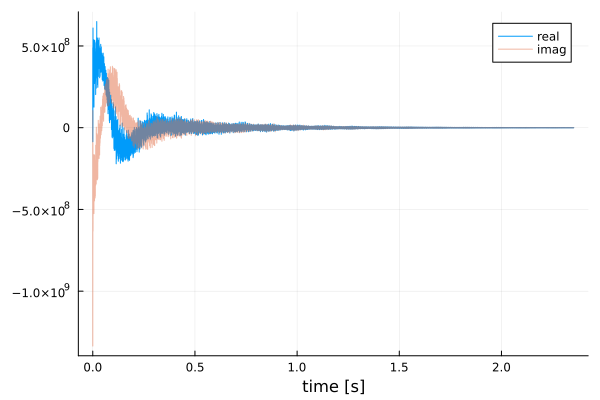

In [5]:
Plots.plot(coords(d,1), real(d),xlabel="time [s]",label="real") 
Plots.plot!(coords(d,1), imag(d),xlabel="time [s]",opacity=0.5,label="imag") 

## Processing NMR data
To process the data, we set up a processing chain, consisting of the
indivdual processing steps. In this case, we zero-fill the data to
64k (``2^{16}``) points, apodize it with a rate of ``0.5\pi\,\mathrm{s^{-1}}``, and then Fourier transform.

In [6]:
process = Chain(
    ZeroFill([2^17]),
    Apodize([0.5π]),
    FourierTransform([2^17],[1])
)

FourierTransform(Integer[1], Integer[131072], true, FFTW forward plan for 131072-element array of ComplexF64
(dft-ct-dit/32
  (dftw-direct-32/8 "t3fv_32_avx2_128")
  (dft-vrank>=1-x32/1
    (dft-ct-dit/32
      (dftw-direct-32/8 "t3fv_32_avx2_128")
      (dft-direct-128-x32 "n1fv_128_avx2_128"))))) ∘ Apodize(Union{Colon, Real}[1.5707963267948966]) ∘ ZeroFill(Union{Colon, Integer}[131072])

`process()` is now a function that we can directly apply to the experimental data. This results in a new `SpectData` object that has its horizontal coordinate
calibrated in Hz:

In [7]:
s = process(d)
s = s / sqrt(sum(conj(s).*s))

131072-element SpectData{ComplexF64, 1} with coords:(-6944.44444444445:0.10596462137993072:6944.44444444445,):
  3.380666594581837e-5 - 6.22473504138963e-5im
 3.3847593189060876e-5 - 6.229641870549019e-5im
  3.384160908664986e-5 - 6.230409826183013e-5im
 3.3838668956464546e-5 - 6.227593753740018e-5im
  3.385278458893006e-5 - 6.222619430495086e-5im
 3.3902111981559234e-5 - 6.216011187720326e-5im
     3.400573857459e-5 - 6.211199286897352e-5im
  3.413013990777908e-5 - 6.212569763356027e-5im
  3.421361102536134e-5 - 6.217476413566504e-5im
  3.427800948913689e-5 - 6.217760082378966e-5im
                       ⋮
  3.461089139458374e-5 - 6.305550018348928e-5im
 3.4572479331549184e-5 - 6.309008765975566e-5im
  3.445301391089847e-5 - 6.326074912312361e-5im
  3.414149144846589e-5 - 6.340589331265256e-5im
 3.3722814274342906e-5 - 6.334488763080155e-5im
  3.339718147663225e-5 - 6.304491658301939e-5im
  3.331147805953023e-5 - 6.264451427984888e-5im
 3.3449634311160005e-5 - 6.233732130209437e-5im
 

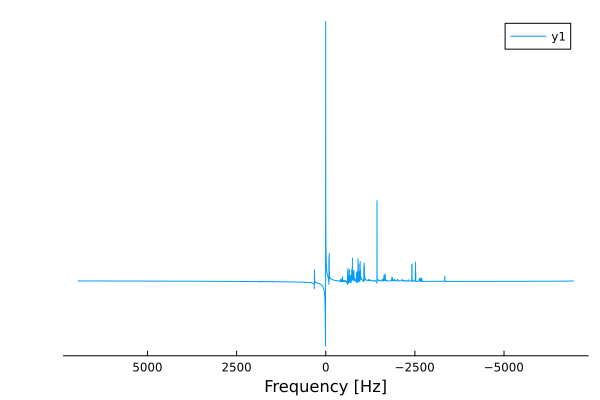

In [8]:
Plots.plot(coords(s,1), real(s),xaxis=:flip,xlabel="Frequency [Hz]",yaxis=false,grid=false)

we can use the coordinate to plot the data over the more familiar ppm scale. 
For this, we need the number of Hz that correspond to 1 ppm. For the Bruker data,
this is found in the parameter `"SFO0"`, which indicates the absolute
frequency of the carrier signal, in the center of the spectrum. In the present example,
the centre of the spectrum corresponds to the water resonance, which appears at 4.78 ppm. We shift
the axis to reflect this.

In [9]:
params

Dict{String, Any} with 235 entries:
  "O4"       => 4323.3
  "PCPD"     => [0, 80, 0, 0, 0, 0, 0, 0, 0, 0]
  "PLWMAX"   => Real[137.28, 0, 0, 0, 0, 0, 0, 0]
  "PQSCALE"  => 1
  "TE"       => 298.0
  "FQ5LIST"  => "<>"
  "RECPRE"   => [-1, 0, -1, -1, -1, -1, -1, -1, -1, -1  …  -1, -1, -1, -1, -1, …
  "VPLIST"   => "<>"
  "VCLIST"   => "<>"
  "O7"       => 4323.3
  "FL3"      => 0
  "FQ6LIST"  => "<>"
  "SW_h"     => 13888.9
  "DATATYPE" => "Parameter Values"
  "RSEL"     => [0, 1, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
  "CNST"     => [1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
  "USERA4"   => "<>"
  "YMAX_a"   => 6.494e8
  "SPOFFS"   => [0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
  ⋮          => ⋮

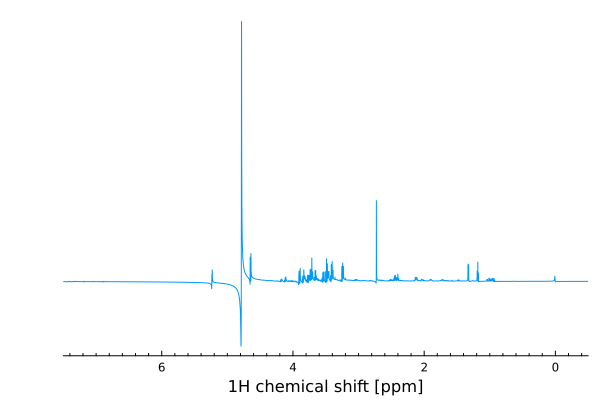

In [13]:
Plots.plot(
    coords(s,1) / params["SFO1"] .+ 4.78,
    real(s),
    xaxis=:flip, xlabel = "1H chemical shift [ppm]", xlims=[-0.5,7.5],
    label=nothing,
    grid=false,
    yaxis=false,
    minorticks=10
)

## Phasing
The spectrum is obviously not properly phased. A zero-order phase correction can be applied simply by multiplying the spectrum
with a complex number ``exp(i \phi)``, where ``\phi``is a phase angle.

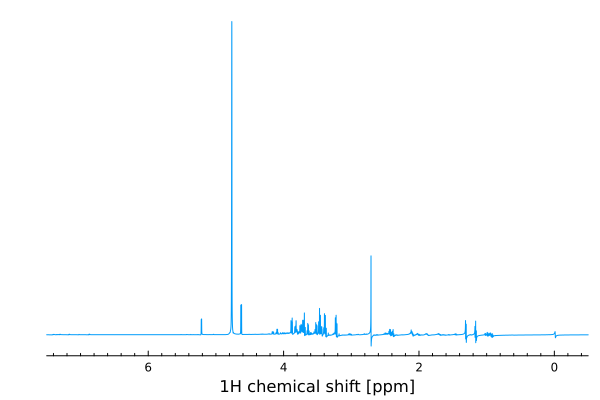

In [14]:
Plots.plot(
    coords(s,1) / params["SFO1"] .+ 4.76,
    real(exp(0.3pi *im)*s),
    xaxis=:flip, xlabel = "1H chemical shift [ppm]", xlims=[-0.5,7.5],
    label=nothing,
    grid=false,
    yaxis=false,
    minorticks=10
)

However, this still leaves a first-order phase error, visible in the right half of the spectrum. This needs to be corrected by multiplying the spectrum with a linearly varying phase correction. In the present example, the correction corresponds to a shift of the time origin in the experimental data by about 70 µs. 

In [16]:
phc1 = exp.(2pi*im*7.0e-5*coords(s,1))

131072-element Vector{ComplexF64}:
 -0.9961946980917458 - 0.08715574274765599im
 -0.9961906350576452 - 0.08720217097897125im
 -0.9961865698597299 - 0.08724859902087519im
 -0.9961825024980089 - 0.08729502687326743im
 -0.9961784329724909 - 0.08734145453604754im
 -0.9961743612831848 - 0.08738788200911381im
 -0.9961702874300994 - 0.08743430929236583im
 -0.9961662114132436 - 0.0874807363857032im
 -0.9961621332326261 - 0.08752716328902418im
 -0.9961580528882561 - 0.08757359000222839im
                     ⋮
 -0.9961621332326261 + 0.08752716328902418im
 -0.9961662114132436 + 0.08748073638570275im
 -0.9961702874300994 + 0.08743430929236583im
 -0.9961743612831848 + 0.08738788200911381im
  -0.996178432972491 + 0.0873414545360471im
 -0.9961825024980089 + 0.08729502687326743im
 -0.9961865698597299 + 0.08724859902087519im
 -0.9961906350576452 + 0.0872021709789708im
 -0.9961946980917458 + 0.08715574274765599im

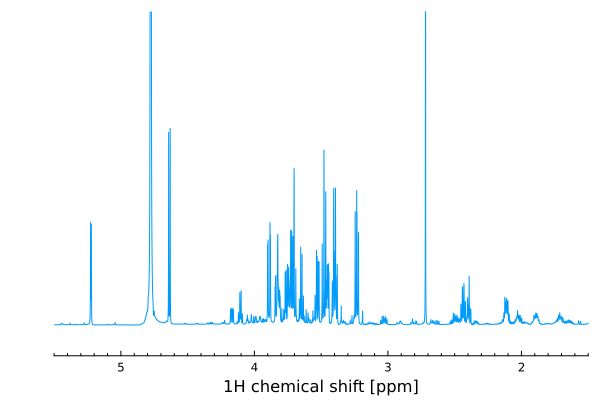

In [19]:
Plots.plot(
    coords(s,1) / params["SFO1"] .+ 4.77,
    real(exp(0.3pi *im)*s.*phc1),
    xaxis=:flip, xlabel = "1H chemical shift [ppm]", xlims=[1.5,5.5],
    label=nothing,
    grid=false,
    yaxis=false,ylims=0.02*[-0.1,1.0],
    minorticks=10,
)

## Computing Integrals
The integral of the spectrum can be computed using the `cumsum` function, which is part of the Julia Base.


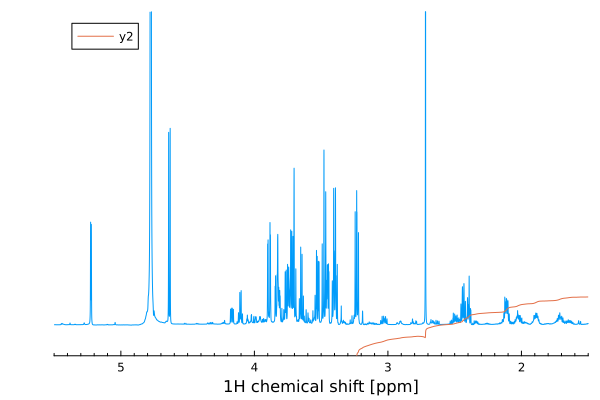

In [20]:
Plots.plot!(reverse(coords(s,1)) / params["SFO1"] .+ 4.77, 1e-3*cumsum(real.(reverse(s))))

This is not a very convincing result, since the baseline of the spectrum is not yet well adjusted. 

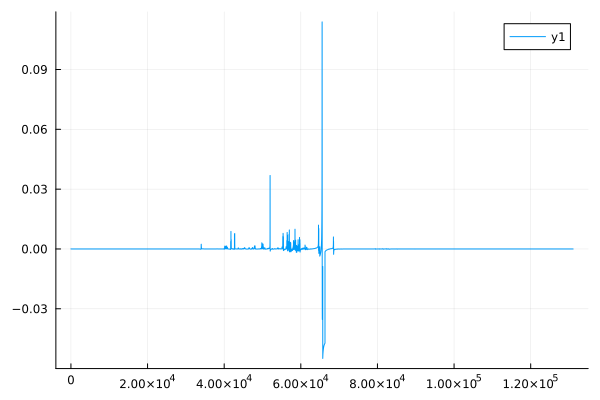

In [21]:
mb=NMRlab.MedianBaselineCorrect(1)
Plots.plot(s |> mb |> real)

In [22]:
mb(s)

131072-element SpectData{ComplexF64, 1} with coords:(-6944.44444444445:0.10596462137993072:6944.44444444445,):
  1.8640199871060218e-5 - 6.22473504138963e-5im
  1.8681127114302726e-5 - 6.229641870549019e-5im
   1.867514301189171e-5 - 6.230409826183013e-5im
  1.8672202881706396e-5 - 6.227593753740018e-5im
   1.868631851417191e-5 - 6.222619430495086e-5im
  1.8735645906801083e-5 - 6.216011187720326e-5im
   1.883927249983185e-5 - 6.211199286897352e-5im
   1.896367383302093e-5 - 6.212569763356027e-5im
  1.9047144950603192e-5 - 6.217476413566504e-5im
  1.9111543414378742e-5 - 6.217760082378966e-5im
                        ⋮
 -1.2327033388525904e-5 - 6.305550018348928e-5im
 -1.2365445451560459e-5 - 6.309008765975566e-5im
 -1.2484910872211171e-5 - 6.326074912312361e-5im
 -1.2796433334643753e-5 - 6.340589331265256e-5im
 -1.3215110508766737e-5 - 6.334488763080155e-5im
 -1.3540743306477393e-5 - 6.304491658301939e-5im
 -1.3622976298750319e-5 - 6.264451427984888e-5im
 -1.3484820047120543e-5 - 6.233

In [23]:
NMRlab.conv(rand(10),rand(5),2)

1-element Vector{Any}:
 Base.OneTo(10)

## Loading a batch of data
Often we are dealing not only with a single spectrum, but an entire batch of them, collected for example over the course of time, or
pertaining to a batch of experiments. In this case, it may make sense to condense the individual data into a 2D set. This can be done
as follows:

In [15]:
dall=[ load(f,:Bruker)[2] for f in NMRlab.Examples.Data["HCC cell culture media spectra"]["files"] ]

43-element Vector{SpectData{ComplexF64, 1}}:
 [-6.9423121078125e7 + 1.047522298828125e8im, 3.713936376171875e8 - 5.873334321640625e8im, 4.89205430609375e8 - 1.33556210878125e9im, 1.36027642265625e7 - 1.0152351535234375e9im, -5.90617235546875e7 - 8.273014788203125e8im, -8.6232552546875e7 - 5.643557254375e8im, -398472.4296875 - 5.26599649140625e8im, -1.78959229921875e7 - 4.263141174296875e8im, 1.67038894921875e7 - 3.65753820171875e8im, 4.84514783984375e7 - 2.174211429765625e8im  …  -416306.875 - 498250.46875im, -283007.765625 - 183694.90625im, -420138.875 + 79240.765625im, -175130.375 + 254453.578125im, -25309.578125 + 487678.984375im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im]
 [-6.73282561328125e7 + 1.239938218125e8im, 3.583411114140625e8 - 6.944526417890625e8im, 4.41280862765625e8 - 1.559643875390625e9im, -4.0729339203125e7 - 1.1775226735859375e9im, -9.28869306328125e7 - 9.791675433671875e8im, -8.57148132578125e7 - 7.056673025078125e8im, 1.4833451578125e7 - 7.031

In [16]:
A=rand(10,20,30)
A[2:end,:,:].-A[1:end-1,:,:]

9×20×30 Array{Float64, 3}:
[:, :, 1] =
  0.414664    0.553305    0.2036     …  -0.125307   -0.689089    0.442882
 -0.0998897  -0.29778     0.0698693      0.650336    0.66829     0.177196
 -0.402042    0.122974   -0.89968       -0.218428   -0.362073   -0.59524
  0.542751    0.093393    0.300352       0.263481    0.50757    -0.132883
 -0.359147    0.0147912  -0.340241      -0.264693   -0.634938    0.654967
  0.585048   -0.750771    0.527278   …  -0.0538221   0.411114   -0.530835
 -0.669986    0.950116   -0.0305542      0.576544   -0.0681415   0.107777
  0.635989   -0.897858   -0.197776      -0.852936   -0.281716    0.421688
 -0.561695    0.739424   -0.173599       0.0963438   0.046133    0.0410402

[:, :, 2] =
  0.0547204  -0.292673    0.164937   …  -0.143513    0.36136    -0.484878
  0.194073    0.383349    0.0747693      0.378343   -0.414737    0.94825
  0.32863    -0.1613     -0.501424       0.146179    0.635317    0.0366437
 -0.522835    0.0745421   0.151096       0.159552   -0.02550